In [33]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.metrics import r2_score

import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

import warnings
warnings.filterwarnings('ignore')


### Reading the merged dataframe

In [2]:
data = pd.read_csv('../../Final_table.csv')
data.head()

,datetime_beginning_ept,MIDATL_solar,OTHER_solar,RFC_solar,RTO_solar,SOUTH_solar,WEST_solar,MIDATL_wind,OTHER_wind,RFC_wind,...,DOM_forecast,DUQ_forecast,EKPC_forecast,MIDATL_forecast,RTO_forecast,DPL_historical_da,forecast_gen_outage_mw_rto,forecast_gen_outage_mw_west,forecast_gen_outage_mw_other,Henry Hub Natural Gas Spot Price (Dollars per Million Btu)
0,19/02/2022 00:00:00 AM,0.0,0.0,0.0,0.0,0.0,0.0,543.833,0.0,7749.579,...,13124.200000,1428.2,1825.200000,29872.800000,90802.0,38.95,3216.836735,267.714286,2949.122449,4.61
1,19/02/2022 01:00:00 AM,0.0,0.0,0.0,0.0,0.0,0.0,631.555,0.0,7669.941,...,13098.200000,1399.4,1818.400000,29506.400000,89577.4,36.43,3216.836735,267.714286,2949.122449,4.61
2,19/02/2022 02:00:00 AM,0.0,0.0,0.0,0.0,0.0,0.0,736.464,0.0,7726.962,...,13255.800000,1381.4,1824.600000,29435.800000,89291.6,36.36,3216.836735,267.714286,2949.122449,4.61
3,19/02/2022 03:00:00 AM,0.0,0.0,0.0,0.0,0.0,0.0,783.231,0.0,7896.692,...,13455.400000,1375.4,1831.400000,29589.800000,89587.8,36.59,3216.836735,267.714286,2949.122449,4.61
4,19/02/2022 04:00:00 AM,0.0,0.0,0.0,0.0,0.0,0.0,860.240,0.0,8150.219,...,13840.333333,1384.5,1882.333333,30146.166667,91159.0,38.60,3216.836735,267.714286,2949.122449,4.61


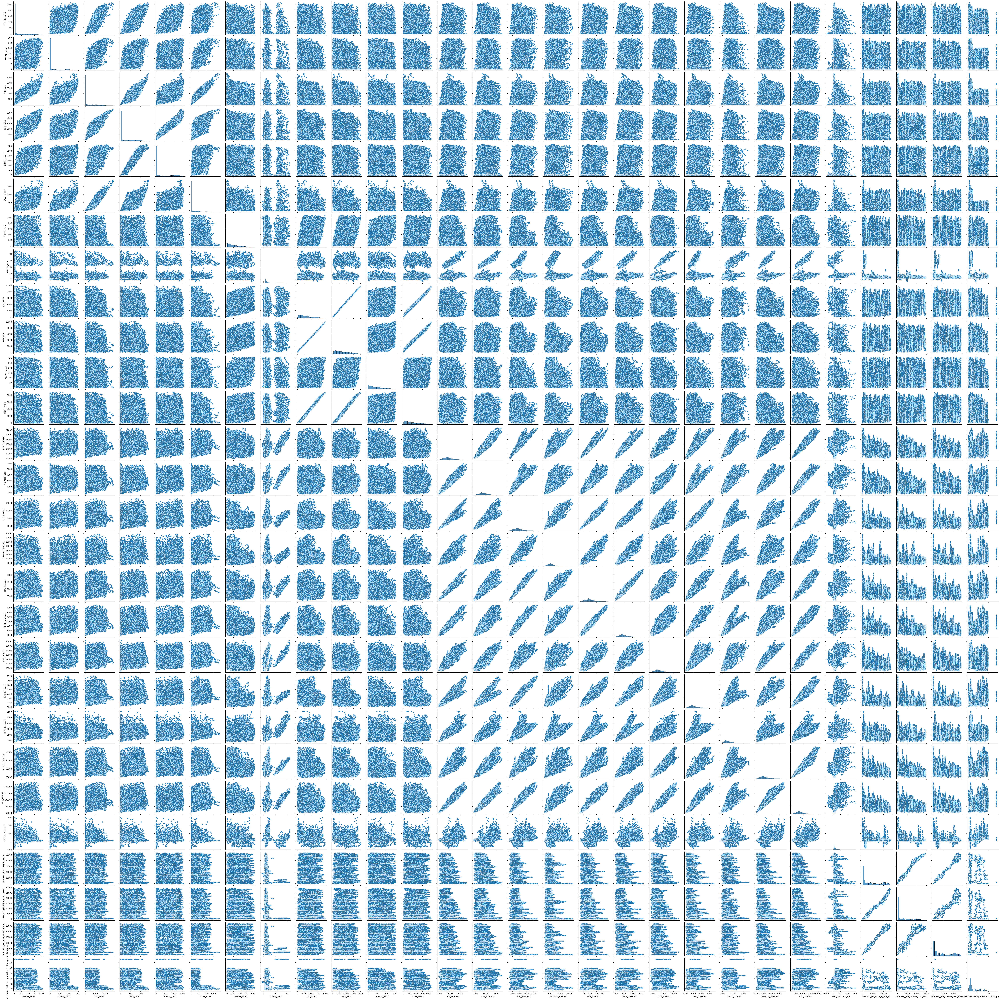

In [28]:
sns.pairplot(data=data)
# y_column = 'DPL_historical_da'
# x_columns = data.columns[data.columns != y_column]
# sns.pairplot(data, x_vars=x_columns, y_vars=[y_column])

<Axes: >

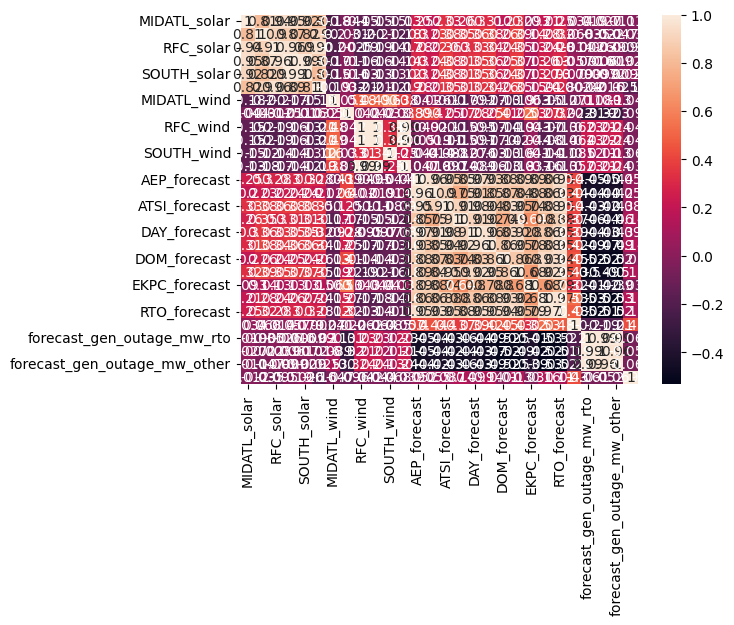

In [4]:
sns.heatmap(data.iloc[:, 1:].corr(), annot=True)

### Splitting the dataframe into test and training sets

In [5]:
feature_var = data.iloc[:,[1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,25,26,27,28]]
target_var = data['DPL_historical_da']

X_train, X_test, y_train, y_test = train_test_split(feature_var, target_var, test_size=0.2, random_state=156)

# Feature Selection

In [29]:
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import f_regression

model_fr = SelectKBest(score_func=f_regression, k=5)

data_new_fr = model_fr.fit(X_train, y_train)

print("the F-test method computes the F-statistic for each feature, measuring the linear dependency between the feature and the target")
print("f_regression: ", data_new_fr.get_feature_names_out())


the F-test method computes the F-statistic for each feature, measuring the linear dependency between the feature and the target
f_regression:  ['APS_forecast' 'DOM_forecast' 'MIDATL_forecast' 'RTO_forecast'
 'Henry Hub Natural Gas Spot Price (Dollars per Million Btu)']


### Observing the details between variane and linear dependancy 

In [8]:
df_fr = pd.DataFrame({'column':X_train.columns, 'p':data_new_fr.pvalues_, 'score':data_new_fr.scores_})
df_fr

,column,p,score
0,MIDATL_solar,4.517937e-05,16.651012
1,OTHER_solar,7.379200e-14,56.080297
2,RFC_solar,8.288970e-02,3.007748
3,RTO_solar,5.620057e-11,43.017026
4,SOUTH_solar,5.462911e-20,84.062532
5,WEST_solar,7.258905e-01,0.122923
6,MIDATL_wind,1.028216e-14,59.973598
7,OTHER_wind,9.349717e-03,6.756675
8,RFC_wind,6.668037e-11,42.681496
9,RTO_wind,1.189798e-11,46.066476


# Lasso Regression

In [34]:
from sklearn import metrics
from sklearn.linear_model import Lasso

model_la = Lasso(alpha=0.1)
# model_la_sub = Lasso(alpha=0.1)

model_la.fit(X_train, y_train)
# model_la_sub.fit(X_train.iloc[:,[13,18,21,22,26]], y_train)

predict = model_la.predict(X_test)
# predict_sub = model_la_sub.predict(X_test.iloc[:,[13,18,21,22,26]])
print('r2 ', r2_score(y_test, predict))
print('mse: ',metrics.mean_squared_error(predict, y_test))
print('mape: ',metrics.mean_absolute_percentage_error(predict, y_test))
# print('mse sub: ',metrics.mean_squared_error(predict_sub, y_test))
# print('mape sub: ',metrics.mean_absolute_percentage_error(predict_sub, y_test))

# coef = pd.DataFrame()
# coef['feature_name'] = X_train.columns
# coef['coefficients'] = pd.Series(model_la.coef_)
# coef

r2  0.48928360508374
mse:  1308.9845339993033
mape:  1.6758892647392005


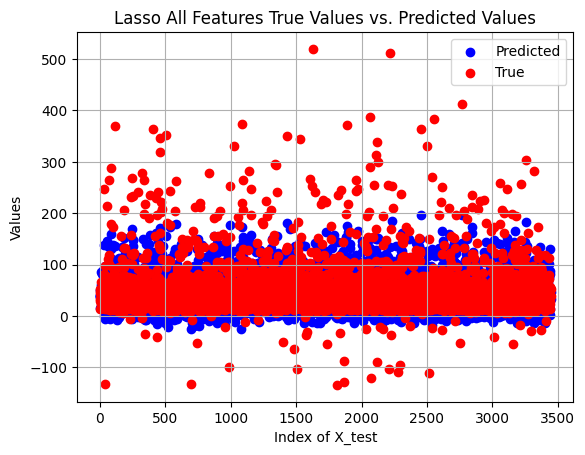

In [10]:
import matplotlib.pyplot as plt

# Assuming X_test, y_test, and predict are your input features, true values, and predicted values respectively

# Create index for X_test
index = range(len(X_test))

# Plotting
plt.scatter(index, predict, color='blue', label='Predicted')
plt.scatter(index, y_test, color='red', label='True')
plt.title('Lasso True Values vs. Predicted Values')
plt.xlabel('Index of X_test')
plt.ylabel('Values')
plt.legend()
plt.grid(True)
plt.show()


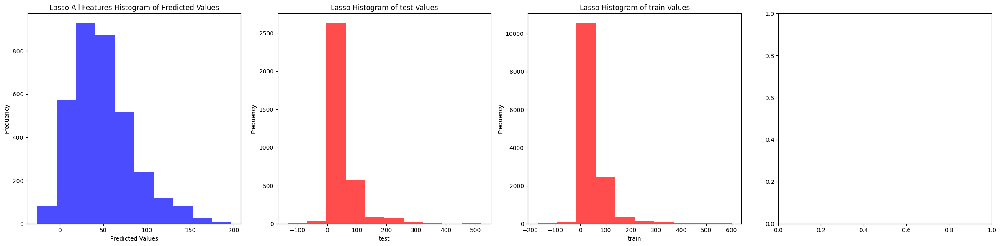

In [30]:


# Create subplots
fig, axs = plt.subplots(1, 4, figsize=(24, 6))

# Plot histogram for predicted values
axs[0].hist(predict, bins=10, color='blue', alpha=0.7)
axs[0].set_title('Lasso Histogram of Predicted Values')
axs[0].set_xlabel('Predicted Values')
axs[0].set_ylabel('Frequency')

# Plot histogram for true values
axs[1].hist(y_test, bins=10, color='red', alpha=0.7)
axs[1].set_title('Lasso Histogram of test Values')
axs[1].set_xlabel('test')
axs[1].set_ylabel('Frequency')

axs[2].hist(y_train, bins=10, color='red', alpha=0.7)
axs[2].set_title('Lasso Histogram of train Values')
axs[2].set_xlabel('train')
axs[2].set_ylabel('Frequency')


# Adjust layout
plt.tight_layout()

# Show plots
plt.show()




# Ridge Regression

In [35]:
from sklearn.linear_model import Ridge

model_rid = Ridge(alpha=0.1)
model_rid.fit(X_train, y_train)
predict_rid = model_rid.predict(X_test)
print('r2 ', r2_score(y_test, predict_rid))
print('mse: ',metrics.mean_squared_error(predict_rid, y_test))
print('mape: ',metrics.mean_absolute_percentage_error(predict_rid, y_test))

# coef = pd.DataFrame()
# coef['feature_name'] = X_train.columns
# coef['coefficients'] = pd.Series(model_rid.coef_)
# coef

r2  0.48966172399081287
mse:  1308.0154016074357
mape:  1.6502707737660387


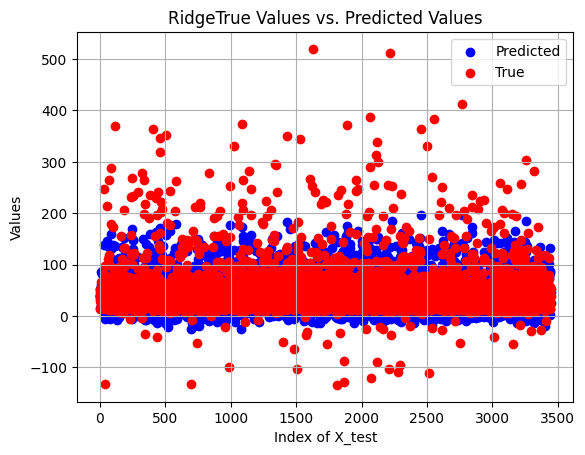

In [14]:
index = range(len(X_test))

# Plotting
plt.scatter(index, predict_rid, color='blue', label='Predicted')
plt.scatter(index, y_test, color='red', label='True')
plt.title('RidgeTrue Values vs. Predicted Values')
plt.xlabel('Index of X_test')
plt.ylabel('Values')
plt.legend()
plt.grid(True)
plt.show()

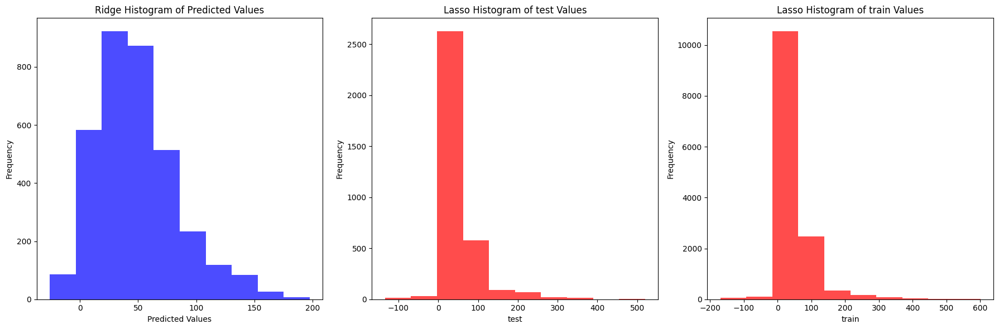

In [15]:
fig, axs = plt.subplots(1, 3, figsize=(18, 6))

# Plot histogram for predicted values
axs[0].hist(predict_rid, bins=10, color='blue', alpha=0.7)
axs[0].set_title('Ridge Histogram of Predicted Values')
axs[0].set_xlabel('Predicted Values')
axs[0].set_ylabel('Frequency')

# Plot histogram for true values
axs[1].hist(y_test, bins=10, color='red', alpha=0.7)
axs[1].set_title('Lasso Histogram of test Values')
axs[1].set_xlabel('test')
axs[1].set_ylabel('Frequency')

axs[2].hist(y_train, bins=10, color='red', alpha=0.7)
axs[2].set_title('Lasso Histogram of train Values')
axs[2].set_xlabel('train')
axs[2].set_ylabel('Frequency')

# Adjust layout
plt.tight_layout()

# Show plots
plt.show()

# Linear Regression

In [37]:
from sklearn.linear_model import LinearRegression

lm = LinearRegression()
lm_sub = LinearRegression()
lm.fit(X_train, y_train)
lm_sub.fit(X_train.iloc[:,[13,18,21,22,26]], y_train)

predict_lm = lm.predict(X_test)
predict_lm_sub = lm_sub.predict(X_test.iloc[:,[13,18,21,22,26]])

print('r2 ', r2_score(y_test, predict_lm))
print('mse: ', metrics.mean_squared_error(y_train, lm.predict(X_train)))
print('r2 sub ', r2_score(y_test, predict_lm_sub))
print('mse sub: ', metrics.mean_squared_error(y_train, lm_sub.predict(X_train.iloc[:,[13,18,21,22,26]])))

r2  0.4893335685265139
mse:  1514.42475086228
r2 sub  0.4618888736511386
mse sub:  1601.5967739940513


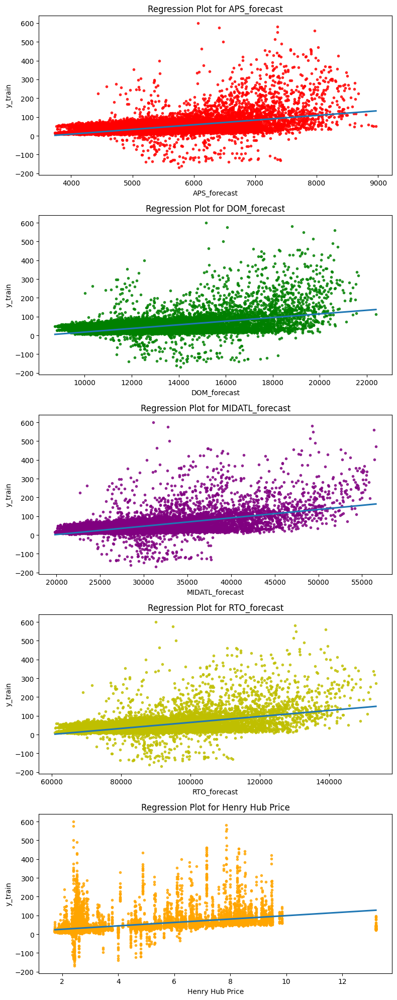

In [17]:

# Assuming X_train and y_train are your training data

# Create individual subplots for each feature
fig, axs = plt.subplots(5, 1, figsize=(8, 20))

# Plotting regression plot for 'APS_forecast'
sns.regplot(x=X_train['APS_forecast'], y=y_train, order=1, ci=None, scatter_kws={'color':'r', 's':9}, ax=axs[0])
axs[0].set_title('Regression Plot for APS_forecast')
axs[0].set_xlabel('APS_forecast')
axs[0].set_ylabel('y_train')

# Plotting regression plot for 'DOM_forecast'
sns.regplot(x=X_train['DOM_forecast'], y=y_train, order=1, ci=None, scatter_kws={'color':'g', 's':9}, ax=axs[1])
axs[1].set_title('Regression Plot for DOM_forecast')
axs[1].set_xlabel('DOM_forecast')
axs[1].set_ylabel('y_train')

# Plotting regression plot for 'MIDATL_forecast'
sns.regplot(x=X_train['MIDATL_forecast'], y=y_train, order=1, ci=None, scatter_kws={'color':'purple', 's':9}, ax=axs[2])
axs[2].set_title('Regression Plot for MIDATL_forecast')
axs[2].set_xlabel('MIDATL_forecast')
axs[2].set_ylabel('y_train')

# Plotting regression plot for 'RTO_forecast'
sns.regplot(x=X_train['RTO_forecast'], y=y_train, order=1, ci=None, scatter_kws={'color':'y', 's':9}, ax=axs[3])
axs[3].set_title('Regression Plot for RTO_forecast')
axs[3].set_xlabel('RTO_forecast')
axs[3].set_ylabel('y_train')

# Plotting regression plot for 'Henry Hub Natural Gas Spot Price (Dollars per Million Btu)'
sns.regplot(x=X_train['Henry Hub Natural Gas Spot Price (Dollars per Million Btu)'], y=y_train, order=1, ci=None, scatter_kws={'color':'orange', 's':9}, ax=axs[4])
axs[4].set_title('Regression Plot for Henry Hub Price')
axs[4].set_xlabel('Henry Hub Price')
axs[4].set_ylabel('y_train')

# Adjust layout
plt.tight_layout()

# Show plots
plt.show()


# Polynomial

In [18]:
from sklearn.preprocessing import PolynomialFeatures
from sklearn.model_selection import cross_validate

from mlxtend.evaluate import bias_variance_decomp

In [19]:
# lm_sub.fit(X_train.iloc[:,[13,18,21,22,26]], y_train)
mse, bias,var = bias_variance_decomp(lm_sub,
                                     X_train.iloc[:,[13,18,21,22,26]].to_numpy(), y_train.to_numpy(), X_test.iloc[:,[13,18,21,22,26]].to_numpy(), y_test.to_numpy(), 
                                     loss='mse', num_rounds=200, random_seed=100)

In [32]:
MSEs   = []
Biases = []
Vars   = []
poly_models = []
from sklearn.metrics import r2_score

# Fit model and collect performance iteratively
for i in range(1,8):
    # Fit a Linear Regression model
    poly         = PolynomialFeatures (degree=i, include_bias=False)
    X_train_poly = poly.fit_transform(X_train.iloc[:,[13,18,21,22,26]])
    X_test_poly  = poly.fit_transform(X_test.iloc[:,[13,18,21,22,26]])

    model = LinearRegression()
    model.fit(X_train_poly, y_train)

    poly_models.append(model)
    
    mse, bias, var = bias_variance_decomp(model,
                                           X_train_poly, y_train.to_numpy(), X_test_poly, y_test.to_numpy(),
                                           loss='mse', num_rounds=200, random_seed=100)

    # Calculate performance
    MSEs.append(mse)
    Biases.append(bias)
    Vars.append(var)
    

    cv_results = cross_validate(model, X_train_poly, y_train, cv=10, scoring='neg_mean_absolute_error')
    mse_avg = -cv_results['test_score'].mean()

    y_pred = model.predict(X_test_poly)
    r2 = r2_score(y_test, y_pred)

    print('Degree: %s, MSE: %s, Bias: %s, Var: %s, Cross-Validation: %s, R2_score %s ' %(i,mse.round(2),bias.round(2),var.round(2),mse_avg.round(2),r2.round(2)))
 

    
    
    # # Plot actual values vs predicted values as a single line
    # plt.figure()
    # plt.scatter(X_test_poly, y_test, color='blue', label='Actual')
    # # plt.plot(X_test_poly, y_pred, color='red')
    # plt.title(f'Actual vs Predicted (Degree {i})')
    # plt.xlabel('X_test_poly')
    # plt.ylabel('y_test')
    # plt.legend()
    # plt.show()

Degree: 1, MSE: 1380.28, Bias: 1379.04, Var: 1.24, Cross-Validation: 21.3, R2_score 0.46 
Degree: 2, MSE: 1158.64, Bias: 1154.46, Var: 4.18, Cross-Validation: 17.82, R2_score 0.55 
Degree: 3, MSE: 1111.93, Bias: 1101.54, Var: 10.39, Cross-Validation: 16.85, R2_score 0.57 
Degree: 4, MSE: 1875.15, Bias: 1399.08, Var: 476.07, Cross-Validation: 25.17, R2_score -0.4 
Degree: 5, MSE: 2338.49, Bias: 1282.94, Var: 1055.55, Cross-Validation: 30.47, R2_score 0.43 
Degree: 6, MSE: 3195.8, Bias: 1320.31, Var: 1875.49, Cross-Validation: 25.12, R2_score -0.23 
Degree: 7, MSE: 2339.89, Bias: 1164.0, Var: 1175.88, Cross-Validation: 24.4, R2_score 0.22 


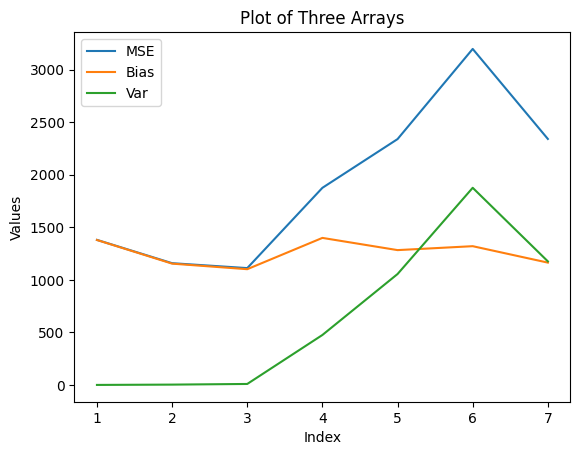

In [31]:
# res = pd.DataFrame([MSEs,Biases,Vars]).T
# res.columns = ['MSE', 'Bias','Var']
# res.plot()

x_values = range(1, len(MSEs) + 1) 
plt.plot(x_values, MSEs, label='MSE')
plt.plot(x_values, Biases, label='Bias')
plt.plot(x_values, Vars, label='Var')
plt.xlabel('Index')
plt.ylabel('Values')
plt.title('Plot of Three Arrays')
plt.legend()

# Show the plot
plt.show()

# Cross Validation

In [27]:
cv_results_la = cross_validate(model_la, feature_var, target_var, cv=10, scoring='neg_mean_absolute_error')
cv_results_rid = cross_validate(model_rid, feature_var, target_var, cv=10, scoring='neg_mean_absolute_error')
cv_results_lm_sub = cross_validate(lm_sub, feature_var, target_var, cv=10, scoring='neg_mean_absolute_error')
cv_results_lm = cross_validate(lm, feature_var, target_var, cv=10, scoring='neg_mean_absolute_error')

mse_avg_la = -cv_results_la['test_score'].mean()
mse_avg_rid = -cv_results_rid['test_score'].mean()
mse_avg_lm_sub = -cv_results_lm_sub['test_score'].mean()
mse_avg_lm = -cv_results_lm['test_score'].mean()

y_pred_la = model.predict(X_test_poly)
y_pred_rid = model.predict(X_test_poly)
y_pred_lm_sub = model.predict(X_test_poly)
y_pred_lm = model.predict(X_test_poly)

r2_la = r2_score(y_test, y_pred_la)
r2_rid = r2_score(y_test, y_pred_rid)
r2_lm_sub = r2_score(y_test, y_pred_lm_sub)
r2_lm = r2_score(y_test, y_pred_lm)

print('Lasso MSE (10-Fold CV): ', mse_avg_la)
print('Ridge MSE (10-Fold CV): ', mse_avg_rid)
print('Linear Subset MSE (10-Fold CV): ', mse_avg_lm_sub)
print('Linear MSE (10-Fold CV): ', mse_avg_lm)



Lasso MSE (10-Fold CV):  26.849212109501032
Ridge MSE (10-Fold CV):  26.9410609067205
Linear Subset MSE (10-Fold CV):  26.948909047833638
Linear MSE (10-Fold CV):  26.948909047833638
